<a id= 'top'></a>
# Sentiment Analysis of SB50

We live in a world of social media and big data, where a huge amount of data is available to us that cannot be analyzed manually. Businesses are really interested in capturing a general emotional trend or attitude about their products, watch how it changes over time, and understand how it relates to their competitors. There is a huge push in the field of data science to come up with better tools for sentiment analysis. I had never worked with textual data before and the field of NLP is really exciting to me! I thought that it would be really interesting to do a basic sentiment analysis about a popular event that is happening in real-time! During the time that I was thinking about this, it was NBA playoffs season and there was a timely game coming up -- Rockets vs Warriors (Game 2; the Rockets lost :-(). I thought it would be awesome to collect information expressed through a big social media platform while the game is happening and then analyze how the sentiment of avid sports fans changed throughout the game. 

- [Training and Testing Twitter Sentiment Corpus from thinknook.com](#1)
- [Testing classification models on thinknook.com training dataset](#2)
- [Predicting Sentiment of SB50 tweets with our trained classifier](#3)
- [Predicting Sentiment of SB50 tweets with Textblob](#4)
- [Conclusions](#5)

In [1]:
%load_ext watermark
%watermark -v -m -p pandas

import pandas as pd
from pandas import DataFrame, Series
from pandas.tseries.resample import TimeGrouper
from pandas.tseries.offsets import DateOffset
import numpy as np
import json
import sklearn 
import seaborn as sns
sns.set_style('whitegrid')
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cross_validation import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import log_loss
from sklearn import metrics
from sklearn.cross_validation import cross_val_score

import plotly as pl
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import Bar, Scatter, Figure, Layout
from plotly.graph_objs import *
import plotly.graph_objs as go
import numpy as np
import cufflinks as cf

from textblob import TextBlob, Word
from textblob.sentiments import NaiveBayesAnalyzer
import nltk

print ("Plotly  ", __version__)
init_notebook_mode(connected=True)

CPython 3.5.2
IPython 4.2.0

pandas 0.18.1

compiler   : GCC 4.4.7 20120313 (Red Hat 4.4.7-1)
system     : Linux
release    : 4.4.0-36-generic
machine    : x86_64
processor  : x86_64
CPU cores  : 20
interpreter: 64bit
Plotly   1.12.9


<a id= '1'></a>
## Training and Testing Twitter Sentiment Corpus

In this work I have used [Twitter Sentiment Analysis corpus](http://thinknook.com/twitter-sentiment-analysis-training-corpus-dataset-2012-09-22/), which contains over a million of analyzed tweets, with positive (1) and negative (0) sentimental weight . Initially I am going to test the performance of few marching leaning algorithm on this data set and in the second section of this notebook I am going to use the best model to evaluate the sentiments of Super Bowl 50 tweets that I cleared in the previous notebook. 

<p>
I used the same method for cleaning and preprocessing the text as mentioned in Step II above. The pertaining code can be found [here](https://github.com/deepnadevkar/twittersentimentanalysis/blob/master/twittersentiment_corpus.ipynb). I ended up using only a small fraction of this corpus (100,000 tweets) due to computational limitations. The code for making this smaller corpus can be found [here](https://github.com/deepnadevkar/twittersentimentanalysis/blob/master/makesmallercorpus.ipynb)
 
[Return to top](#top)

In [2]:
train = pd.read_csv('../Data/train_mini.csv')
train.dropna(inplace = True)
train.head()

,﻿ItemID,Sentiment,SentimentSource,SentimentText,cleantweets
0,405622,0,Sentiment140,@sabrinamff no biscuits? its ok i still LOVE ...,sabrinamff biscuits ok still love
1,960407,1,Sentiment140,Just left Anna Maria Beach!! Love that place!!,left anna maria beach love place
2,820481,1,Sentiment140,Hey New Tweeps! DM me to introduce yourselves,hey new tweeps dm introduce
3,6347,1,Sentiment140,#f1 - renault spun off but this time it was no...,f renault spun time piquet
4,599515,0,Sentiment140,baltimore waste management didn't pick up my p...,baltimore waste management pick paper recyclab...


 We are going to split the train data set to training, 90%, and testing, 10% of our datafram. 

In [3]:
X_train, X_test, Y_train, Y_test = train_test_split(train['cleantweets'], train['Sentiment'],test_size=0.1)
X_train.head()

29886    loic working tech companies great especially k...
41049    rude simon cowell gonna win vote good evans po...
42832    enjoying pool today love less degree days phoenix
4289                       emily mx romania woke early old
42566                     punktorah anything need anything
Name: cleantweets, dtype: object

In [4]:
Y_train.head()

29886    1
41049    1
42832    1
4289     1
42566    1
Name: Sentiment, dtype: int64

 It first divides the number of occurrences of each word in a document by the total number of words in the document:  these new features are called tf for Term Frequencies. Another refinement on top of tf is to downscale weights for the less informative words that occur in the corpus than those that occur only in a smaller portion of the corpus. This downscaling is called tf–idf for “Term Frequency times Inverse Document Frequency”.
 
In the following section we going to convert our text data so that the clasificaiton models can be applied to them. Thus, we are going to convert our collection of texts to a matrix of token counts using "TfidfVectorizer" object, which is sklearn's refined bag of words tool



In [5]:
vectorizer = TfidfVectorizer(analyzer = "word",tokenizer = None,preprocessor = None, stop_words = None,
                             max_features = 5000)

fit_transform() does two functions: First, it fits the model and learns the vocabulary; second, it transforms our training data into feature vectors.  The input to fit_transform should be a list of string

In [6]:
X_train_list = X_train.tolist()
train_data_features = vectorizer.fit_transform(X_train_list)
train_data_features = train_data_features.toarray()
train_data_features

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]])

Get a bag of words for the test set, and convert to a numpy array
VERY IMPORTANT: On test data, we ONLY use transform... we DO NOT FIT IT! 

In [7]:
X_test_list = X_test.tolist()
test_data_features = vectorizer.transform(X_test_list)
test_data_features = test_data_features.toarray()
test_data_features

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]])

<a id= '1'></a>

# Testing classification models on thinknook.com training dataset
[Return to top](#top)

n_estimators:  50 train_score:  0.931723961633 test_score: 0.740122036611 log_loss: 0.529171584412
n_estimators:  100 train_score:  0.935469529748 test_score: 0.739621886566 log_loss: 0.525824727189
n_estimators:  150 train_score:  0.936836606538 test_score: 0.741322396719 log_loss: 0.525618783622
n_estimators:  200 train_score:  0.937470129928 test_score: 0.743623086926 log_loss: 0.523019964259
n_estimators:  250 train_score:  0.937603503273 test_score: 0.741722516755 log_loss: 0.523848589168
n_estimators:  300 train_score:  0.937070009892 test_score: 0.740822246674 log_loss: 0.524632262565
n_estimators:  350 train_score:  0.938114767764 test_score: 0.741522456737 log_loss: 0.524685693501
n_estimators:  400 train_score:  0.938225912218 test_score: 0.741422426728 log_loss: 0.524645308852


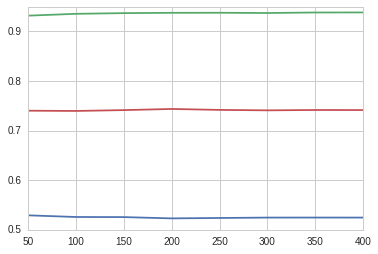

In [8]:
from sklearn.metrics import log_loss

LLscores_test = []
LLscores_train = []
LLscores = []

for a in range (50, 450, 50):
    
    model = RandomForestClassifier(n_estimators = a , 
                                   min_samples_split = 100, 
                                   n_jobs = -1)
    
    model.fit(train_data_features, Y_train)
    test_pred = np.array(model.predict_proba(test_data_features))
    
    train_score = model.score(train_data_features, Y_train)
    test_score = model.score(test_data_features, Y_test)
    Lscores = log_loss(Y_test, test_pred) 
    
    print ("n_estimators: ", a, "train_score: ", train_score, "test_score:", test_score, "log_loss:", Lscores)
    
    LLscores_train.append(train_score)
    LLscores_test.append(test_score)
    LLscores.append(Lscores)
    
df  = pd.DataFrame({'n_estimators': range(50, 450, 50), 
                    'score_train': LLscores_train, 
                    'scores_test': LLscores_test, 
                    'log_loss': LLscores})
df= df.set_index(['n_estimators'])
plt.plot(df)

alpha:  1 train_score:  0.7735765174 test_score: 0.748424527358 log_loss: 0.531782404094
alpha:  11 train_score:  0.770764562702 test_score: 0.752125637691 log_loss: 0.553252401575
alpha:  21 train_score:  0.767674746869 test_score: 0.751125337601 log_loss: 0.566719202773
alpha:  31 train_score:  0.764796105498 test_score: 0.748024407322 log_loss: 0.576466290818
alpha:  41 train_score:  0.762262011937 test_score: 0.745623687106 log_loss: 0.584116601599
alpha:  51 train_score:  0.760605959566 test_score: 0.743523056917 log_loss: 0.590407656501
alpha:  61 train_score:  0.75896102164 test_score: 0.740922276683 log_loss: 0.595740426521
alpha:  71 train_score:  0.757216053705 test_score: 0.739821946584 log_loss: 0.600358843531
alpha:  81 train_score:  0.756015693597 test_score: 0.740522156647 log_loss: 0.60442313487
alpha:  91 train_score:  0.754882020162 test_score: 0.738821646494 log_loss: 0.608044575249


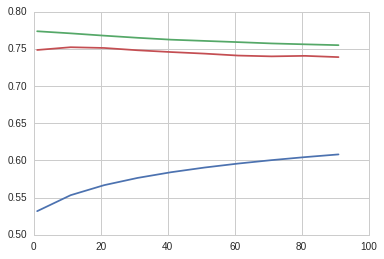

In [9]:
LLscores_test = []
LLscores_train = []
LLscores = []
for a in range (1, 100, 10):
    
    model = MultinomialNB(alpha = a)
    
    model.fit(train_data_features, Y_train)
    test_pred = np.array(model.predict_proba(test_data_features))
    
    train_score = model.score(train_data_features, Y_train)
    test_score = model.score(test_data_features, Y_test)
    Lscores = log_loss(Y_test, test_pred) 
    
    print ("alpha: ", a, "train_score: ", train_score, "test_score:", test_score, "log_loss:", Lscores)
    
    LLscores_train.append(train_score)
    LLscores_test.append(test_score)
    LLscores.append(Lscores)


df  = pd.DataFrame({'alpha': range(1, 100, 10), 
                    'score_train': LLscores_train, 
                    'scores_test': LLscores_test, 
                    'log_loss': LLscores})
df= df.set_index(['alpha'])
plt.plot(df)

n_neighbors:  10 train_score:  0.694730641415 test_score: 0.602280684205
n_neighbors:  30 train_score:  0.602669689796 test_score: 0.575472641793
n_neighbors:  50 train_score:  0.589399041935 test_score: 0.560768230469
n_neighbors:  70 train_score:  0.565658586465 test_score: 0.555566670001
n_neighbors:  90 train_score:  0.55366609983 test_score: 0.548764629389


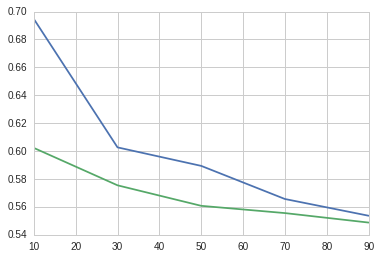

In [10]:
LLscores_test = []
LLscores_train = []
LLscores = []
for a in range (10, 100, 20):
    
    model = KNeighborsClassifier(n_neighbors = a, 
                                 n_jobs = -1)
    
    model.fit(train_data_features, Y_train)
    test_pred = np.array(model.predict_proba(test_data_features))
    
    train_score = model.score(train_data_features, Y_train)
    test_score = model.score(test_data_features, Y_test)
    
    print ("n_neighbors: ", a, "train_score: ", train_score, "test_score:", test_score)
   
    
    LLscores_train.append(train_score)
    LLscores_test.append(test_score)

df  = pd.DataFrame({'n_neighbors': range(10, 100, 20), 
                    'score_train': LLscores_train, 
                    'scores_test': LLscores_test 
                   })
df= df.set_index(['n_neighbors'])
plt.plot(df)


<a id= '3'></a>

## Predicting Sentiment of SB50 tweets with our trained classifier 
| around 75% accuracy score. However, since the MNB classifier had the most balanced precision and recall scores for positive and negative reviews, I used the MNB classifier to predict sentiment scores on my tweets. 

[Return to top](#top)

In [11]:
sb50 = pd.read_csv('../Data/sb50clean_ver1.csv', parse_dates  =['Created'], index_col=0)
#sb50= sb50[:20000]
sb50.tail()

,geo,Created,cleantweets,cleansource
2046247,NaN,2016-02-08 11:22:24,coopjet live england super bowl dosent start t...,twitter iphone
2046248,NaN,2016-02-08 11:22:24,important message behind beyonc super bowl outfit,facebook
2046249,NaN,2016-02-08 11:22:24,dm super bowl,twitter web client
2046250,NaN,2016-02-08 11:22:24,federikoraivan homophobes hating lady gaga hal...,twitter windows phone
2046251,NaN,2016-02-08 11:22:24,empiremagazine icymi war know xmenapocalypse,flipboard


In [12]:
sb50 = sb50.fillna('')
sb50.tail()

,geo,Created,cleantweets,cleansource
2046247,,2016-02-08 11:22:24,coopjet live england super bowl dosent start t...,twitter iphone
2046248,,2016-02-08 11:22:24,important message behind beyonc super bowl outfit,facebook
2046249,,2016-02-08 11:22:24,dm super bowl,twitter web client
2046250,,2016-02-08 11:22:24,federikoraivan homophobes hating lady gaga hal...,twitter windows phone
2046251,,2016-02-08 11:22:24,empiremagazine icymi war know xmenapocalypse,flipboard


In [13]:
sb50_list = sb50['cleantweets'].values
sb50_list = sb50_list.tolist()
sb50_list[0:5]

['kinda wonder beyonc bring lady gaga preform song together',
 'orange crush taking broncos win super bowl sbvote sportscenter',
 'turns grass greener side secrets behind grass super bowl espnmag superbowl',
 'mkbhd worry one day super bowl k',
 'super bowl greatest plays']

In [14]:
sb50_features = vectorizer.transform(sb50_list)
sb50_features = sb50_features.toarray()
sb50_features

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]])

In [15]:
mnb = MultinomialNB() 

mnb = mnb.fit( train_data_features, Y_train )

mnb_test_pred = mnb.predict(test_data_features)
mnb_test_score = mnb.score(test_data_features, Y_test)

print (mnb_test_score)
print (metrics.confusion_matrix(Y_test, mnb_test_pred))
print (metrics.classification_report(Y_test, mnb_test_pred))

0.748424527358
[[3654 1268]
 [1247 3828]]
             precision    recall  f1-score   support

          0       0.75      0.74      0.74      4922
          1       0.75      0.75      0.75      5075

avg / total       0.75      0.75      0.75      9997



In [16]:
mnb_sb50_pred = mnb.predict(sb50_features)

In [17]:
sb50['sentiments'] = mnb_sb50_pred
sb50.tail()

,geo,Created,cleantweets,cleansource,sentiments
2046247,,2016-02-08 11:22:24,coopjet live england super bowl dosent start t...,twitter iphone,1
2046248,,2016-02-08 11:22:24,important message behind beyonc super bowl outfit,facebook,1
2046249,,2016-02-08 11:22:24,dm super bowl,twitter web client,1
2046250,,2016-02-08 11:22:24,federikoraivan homophobes hating lady gaga hal...,twitter windows phone,0
2046251,,2016-02-08 11:22:24,empiremagazine icymi war know xmenapocalypse,flipboard,1


In [18]:
sb50['sentiments'] = sb50.sentiments.map({0: "Negative", 1: "Positive"})
sb50.tail()

,geo,Created,cleantweets,cleansource,sentiments
2046247,,2016-02-08 11:22:24,coopjet live england super bowl dosent start t...,twitter iphone,Positive
2046248,,2016-02-08 11:22:24,important message behind beyonc super bowl outfit,facebook,Positive
2046249,,2016-02-08 11:22:24,dm super bowl,twitter web client,Positive
2046250,,2016-02-08 11:22:24,federikoraivan homophobes hating lady gaga hal...,twitter windows phone,Negative
2046251,,2016-02-08 11:22:24,empiremagazine icymi war know xmenapocalypse,flipboard,Positive


In [19]:
sent = sb50.sentiments.value_counts()

iplot(sent.iplot(asFigure=True,
                 kind='bar',
                 xTitle='',
                 yTitle='Numebr of Tweets',
                 title='sentement'))

<a id= '4'></a>

## Predicting Sentiment of SB50 tweets with Textblob: 

TextBlob is a Python library for natural language processing of textual data. It is trained on a lexicon of adjectives that occur frequently in product reviews and returns a polarity score between -1.0 and 1.0, with -1 being negative and +1 positive. So in the flowing I have tagged the values more than 0.25 positive and less than 0.25 negative and in between is neutral.    
 

[Return to top](#top)

In [20]:
sentiments = [TextBlob(tweet).sentiment.polarity for tweet in sb50['cleantweets']]
#sentiments = [TextBlob(tweet, analyzer=NaiveBayesAnalyzer()).sentiment for tweet in sb50['cleantweets']]

In [21]:
print (sb50['cleantweets'][:5], sentiments[:5])

0    kinda wonder beyonc bring lady gaga preform so...
1    orange crush taking broncos win super bowl sbv...
2    turns grass greener side secrets behind grass ...
3                     mkbhd worry one day super bowl k
4                            super bowl greatest plays
Name: cleantweets, dtype: object [0.0, 0.5666666666666667, -0.033333333333333354, 0.3333333333333333, 0.6666666666666666]


In [22]:
avg_sentiment = np.sum(sentiments)/len(sentiments)
print (avg_sentiment)

0.270563300507


In [23]:
textblobsent = pd.DataFrame()
textblobsent['sent'] = sentiments
textblobsent.head()

,sent
0,0.000000
1,0.566667
2,-0.033333
3,0.333333
4,0.666667


In [24]:
sb50['textblobsent'] = sentiments
sb50.head()

,geo,Created,cleantweets,cleansource,sentiments,textblobsent
0,,2016-02-07 19:33:49,kinda wonder beyonc bring lady gaga preform so...,twitter iphone,Positive,0.000000
1,,2016-02-07 19:33:49,orange crush taking broncos win super bowl sbv...,twitter ipad,Positive,0.566667
2,,2016-02-07 19:33:49,turns grass greener side secrets behind grass ...,twitter iphone,Negative,-0.033333
3,,2016-02-07 19:33:50,mkbhd worry one day super bowl k,twitter iphone,Positive,0.333333
4,,2016-02-07 19:33:50,super bowl greatest plays,kindle,Positive,0.666667


In [25]:
sent = sb50.textblobsent.value_counts()

iplot(textblobsent.iplot(asFigure=True,
                 kind='histogram',
                 xTitle='',
                 yTitle='Numebr of Tweets',
                 title='sentement'))

In [26]:
posnegneut = []
for sentiment in sentiments:
    if sentiment <= -0.25:
        posnegneut.append('Negative')
    elif sentiment >= 0.25:
        posnegneut.append('Positive')
    elif sentiment > -0.25 and sentiment < 0.25:
        posnegneut.append('Neutral')
sb50['SentimentCategory'] = np.array(posnegneut)
sb50.head()

,geo,Created,cleantweets,cleansource,sentiments,textblobsent,SentimentCategory
0,,2016-02-07 19:33:49,kinda wonder beyonc bring lady gaga preform so...,twitter iphone,Positive,0.000000,Neutral
1,,2016-02-07 19:33:49,orange crush taking broncos win super bowl sbv...,twitter ipad,Positive,0.566667,Positive
2,,2016-02-07 19:33:49,turns grass greener side secrets behind grass ...,twitter iphone,Negative,-0.033333,Neutral
3,,2016-02-07 19:33:50,mkbhd worry one day super bowl k,twitter iphone,Positive,0.333333,Positive
4,,2016-02-07 19:33:50,super bowl greatest plays,kindle,Positive,0.666667,Positive


In [27]:
sentCategorical = sb50.SentimentCategory.value_counts()

iplot(sentCategorical.iplot(asFigure=True,
                 kind='bar',
                 xTitle='',
                 yTitle='Numebr of Tweets',
                 title='sentement'))

In [28]:
sb50.set_index('Created', inplace=True)
sb50.index = sb50.index.tz_localize('UTC').tz_convert('EST')
sb50.tail()

,geo,cleantweets,cleansource,sentiments,textblobsent,SentimentCategory
Created,,,,,,
2016-02-08 06:22:24-05:00,,coopjet live england super bowl dosent start t...,twitter iphone,Positive,0.234848,Neutral
2016-02-08 06:22:24-05:00,,important message behind beyonc super bowl outfit,facebook,Positive,0.111111,Neutral
2016-02-08 06:22:24-05:00,,dm super bowl,twitter web client,Positive,0.333333,Positive
2016-02-08 06:22:24-05:00,,federikoraivan homophobes hating lady gaga hal...,twitter windows phone,Negative,0.333333,Positive
2016-02-08 06:22:24-05:00,,empiremagazine icymi war know xmenapocalypse,flipboard,Positive,0.000000,Neutral


In [29]:
sb50['cleantweets1'] = sb50['cleantweets'].dropna(inplace = False)

In [30]:
number = sb50['textblobsent'].resample('1t', how='mean')
number.head()

/home/srs/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:1: FutureWarning:

how in .resample() is deprecated
the new syntax is .resample(...).mean()



Created
2016-02-07 14:33:00-05:00    0.317192
2016-02-07 14:34:00-05:00    0.316496
2016-02-07 14:35:00-05:00    0.321062
2016-02-07 14:36:00-05:00    0.304626
2016-02-07 14:37:00-05:00    0.305258
Freq: T, Name: textblobsent, dtype: float64

In [31]:

iplot(number.iplot(asFigure=True,
                 kind='scatter',
                 xTitle='',
                 yTitle='Numebr of Tweets',
                 title='sentement'))

<center> On interesting observe form the above plot is that the average positive sentiment for the game was higher before the game stared. 


In [32]:
number = sb50[['geo','cleantweets']].resample('T', how='count')

/home/srs/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:1: FutureWarning:

how in .resample() is deprecated
the new syntax is .resample(...).count()



In [33]:
print (('The most negative tweet:'), sb50[sb50['textblobsent']==sb50['textblobsent'].min()]['cleantweets'])
print (('The most positive tweet:'), sb50[sb50['textblobsent']==sb50['textblobsent'].max()]['cleantweets'])

The most negative tweet: Created
2016-02-07 14:36:27-05:00                                               boring
2016-02-07 14:36:56-05:00                                whoreheycorona boring
2016-02-07 14:37:32-05:00    bud brown hanfordtopdawgd helped start nasty b...
2016-02-07 14:38:47-05:00    sb prediction bunch prop bet predictions click...
2016-02-07 14:40:43-05:00                             worst mood bc work today
2016-02-07 14:41:47-05:00                          nba films worst commercials
2016-02-07 14:42:08-05:00                                           disgusting
2016-02-07 14:46:05-05:00                                       disgusting omg
2016-02-07 14:49:39-05:00                              cry every time pathetic
2016-02-07 14:53:39-05:00    mi parte favorita del superbowl es cuando uso ...
2016-02-07 14:56:19-05:00                  terrible tweet btw know went auburn
2016-02-07 14:56:22-05:00          fan however terrible headline grabbing mail
2016-02-07 15:03:27

<a id= '5'></a>

##  Conclusions:

- Neither method is perfect and there are a measures that can be taken in order to improve accuracy of classification and consequently predicting the tweets sentiments. 

- Better text processing can help train the models more accurately. For instance, by keeping punctuations we can process common emoticons. Many of our tweets comes with a link attached to them, so by utilizing Beautiful Soup we can analyze the liked websites and analyze the meaning of that.  

- Find a better matched Corpus or randomly select a dataset from sb50 and manually singe sentiments. 

[Return to top](#top)